2018-2019 gives better data

# Gradient Boosting Regressor

In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ecotools.pi_client import pi_client

sns.set('paper')
# Option Paramater time_zone
# default timezone is time_zone='America/Los_Angeles' use https://www.iana.org/time-zones 

#pi = pi_client(username= r'ad3\username')
pi = pi_client(username = r'ad3\dlrueda')

ad3\dlrueda, please provide your password (text will be hidden) 
>>········
save password? [y/n] /n after saving, set username = 'file' to use this feature 
>>n


In [100]:
# tags = pi.search_by_point(['aiTIT4045*'])

tags = pi.search_by_point(['Chemistry_ChilledWater_Demand_kBtu', 'aiTIT4045'])

tags

['Chemistry_ChilledWater_Demand_kBtu', 'aiTIT4045']

In [101]:
# Required parameters
start = '2018-09-01'
end = '2019-09-01'    

calc = 'summary' # Can be 'summary', 'interpolated', or 'recorded'
interval = '1h' # Can be '15min', '1h', '1d', or '1mo'   

# Extras
chunk_size = 10
weight = 'TimeWeighted'
summary_calc = 'average' # Can be 'average', 'minimum', 'maximum', 'range', 'stddev', 'count', 'percentgood', 'max', 'total', 'none', 'all'
max_count = round(1500000/len(tags))

df = pi.get_stream_by_point(tags, start=start, end=end, _convert_cols=False, calculation=calc, 
                            interval=interval, _weight=weight, _summary_type=summary_calc, _max_count=max_count, 
                            _chunk_size=chunk_size)
df.head()

19:56:26: Sending API request... Chunk 1 of 1
19:56:29: Response recieved for 2 tags! (2.51)


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045
Timestamp,,
2018-09-01 00:00:00,1704.0,67.071167
2018-09-01 01:00:00,1704.0,65.564086
2018-09-01 02:00:00,1704.0,64.364953
2018-09-01 03:00:00,1704.0,64.004323
2018-09-01 04:00:00,1704.0,63.287432


## EDA

In [4]:
import matplotlib as mpl
mpl.style.use('seaborn-whitegrid')

Text(0, 0.5, 'Demand kBtu')

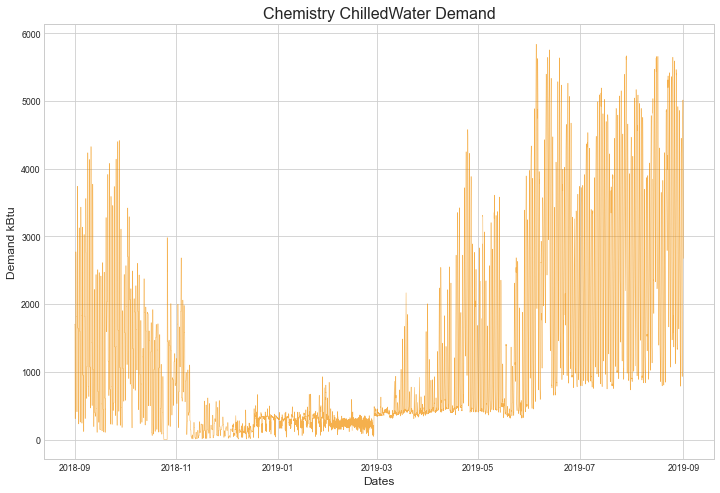

In [102]:
plt.figure(figsize=(12,8))
plt.plot(df['Chemistry_ChilledWater_Demand_kBtu'], color='#F18F01', linewidth=0.5, alpha = 0.7)


plt.title('Chemistry ChilledWater Demand', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

Text(0, 0.5, 'Degrees')

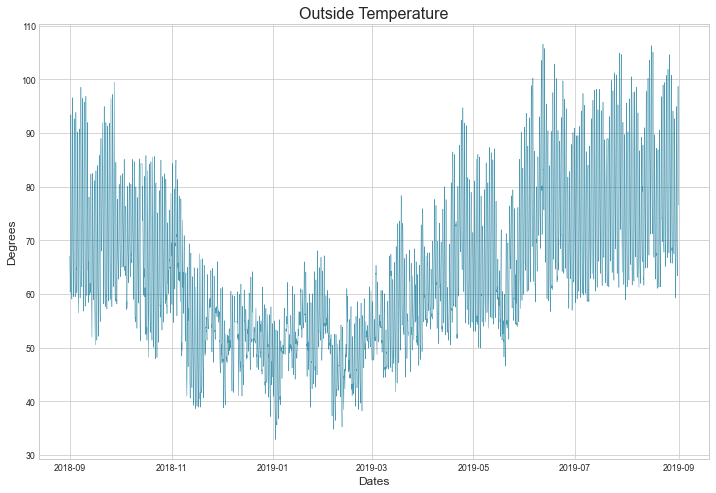

In [103]:
plt.figure(figsize=(12,8))
plt.plot(df['aiTIT4045'], color='#006E90', linewidth=0.5, alpha = 0.7)


plt.title('Outside Temperature', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Degrees', fontsize = 12)


## Add HDH

In [104]:
df['HDH'] = 65 - df['aiTIT4045']
df.loc[df['HDH'] < 0, 'HDH'] = 0
df


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH
Timestamp,,,
2018-09-01 00:00:00,1704.000000,67.071167,0.000000
2018-09-01 01:00:00,1704.000000,65.564086,0.000000
2018-09-01 02:00:00,1704.000000,64.364953,0.635047
2018-09-01 03:00:00,1704.000000,64.004323,0.995677
2018-09-01 04:00:00,1704.000000,63.287432,1.712568
...,...,...,...
2019-08-31 19:00:00,4407.541591,90.589236,0.000000
2019-08-31 20:00:00,4062.785286,85.629170,0.000000
2019-08-31 21:00:00,3611.800603,81.986887,0.000000


## Add CDH

In [105]:
df['CDH'] = (df['aiTIT4045'] - 65)**2
df.loc[df['CDH'] < 0, 'CDH'] = 0
df


,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH
Timestamp,,,,
2018-09-01 00:00:00,1704.000000,67.071167,0.000000,4.289731
2018-09-01 01:00:00,1704.000000,65.564086,0.000000,0.318193
2018-09-01 02:00:00,1704.000000,64.364953,0.635047,0.403285
2018-09-01 03:00:00,1704.000000,64.004323,0.995677,0.991373
2018-09-01 04:00:00,1704.000000,63.287432,1.712568,2.932888
...,...,...,...,...
2019-08-31 19:00:00,4407.541591,90.589236,0.000000,654.808987
2019-08-31 20:00:00,4062.785286,85.629170,0.000000,425.562645
2019-08-31 21:00:00,3611.800603,81.986887,0.000000,288.554334


## Add Day of Week

In [106]:
df.reset_index(inplace=True)
df['DayOfWeek'] = df['Timestamp'].dt.strftime('%w')
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6


## Add Holiday

In [107]:
tags = pi.search_by_point(['ACE_Holidays_Boolean'])

tags

['ACE_Holidays_Boolean']

In [108]:
# Required parameters
start = '2018-09-01'
end = '2019-09-01'    

calc = 'summary' # Can be 'summary', 'interpolated', or 'recorded'
interval = '1h' # Can be '15min', '1h', '1d', or '1mo'   

# Extras
chunk_size = 10
weight = 'TimeWeighted'
summary_calc = 'average' # Can be 'average', 'minimum', 'maximum', 'range', 'stddev', 'count', 'percentgood', 'max', 'total', 'none', 'all'
max_count = round(1500000/len(tags))

hol = pi.get_stream_by_point(tags, start=start, end=end, _convert_cols=False, calculation=calc, 
                            interval=interval, _weight=weight, _summary_type=summary_calc, _max_count=max_count, 
                            _chunk_size=chunk_size)
hol.head()

19:57:06: Sending API request... Chunk 1 of 1
19:57:07: Response recieved for 1 tags! (0.48)


,ACE_Holidays_Boolean
Timestamp,
2018-09-01 00:00:00,1.0
2018-09-01 01:00:00,1.0
2018-09-01 02:00:00,1.0
2018-09-01 03:00:00,1.0
2018-09-01 04:00:00,1.0


In [109]:
hol.reset_index(inplace=True)

In [110]:
df['Holiday'] = hol.ACE_Holidays_Boolean
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0


## Add Month of year

In [111]:
df['Month'] = pd.to_datetime(df['Timestamp']).apply(lambda x: '{month}'.format(month = x.month))
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday,Month
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0,9
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0,9
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0,9
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0,9
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0,9


## Add hour

In [112]:
#df.reset_index(inplace=True)
df['Hour'] = pd.to_datetime(df['Timestamp']).apply(lambda x: '{hour}'.format(hour = x.hour))
df.head()


,Timestamp,Chemistry_ChilledWater_Demand_kBtu,aiTIT4045,HDH,CDH,DayOfWeek,Holiday,Month,Hour
0,2018-09-01 00:00:00,1704.0,67.071167,0.000000,4.289731,6,1.0,9,0
1,2018-09-01 01:00:00,1704.0,65.564086,0.000000,0.318193,6,1.0,9,1
2,2018-09-01 02:00:00,1704.0,64.364953,0.635047,0.403285,6,1.0,9,2
3,2018-09-01 03:00:00,1704.0,64.004323,0.995677,0.991373,6,1.0,9,3
4,2018-09-01 04:00:00,1704.0,63.287432,1.712568,2.932888,6,1.0,9,4


In [113]:
df['Hour'] = df['Hour'].astype('int64')
df['Month'] = df['Month'].astype('int64')
df['DayOfWeek'] = df['DayOfWeek'].astype('int64')
df.dtypes

Timestamp                             datetime64[ns]
Chemistry_ChilledWater_Demand_kBtu           float64
aiTIT4045                                    float64
HDH                                          float64
CDH                                          float64
DayOfWeek                                      int64
Holiday                                      float64
Month                                          int64
Hour                                           int64
dtype: object

## EDA

In [13]:
from dataprep.eda import plot

  0%|          | 0/417 [00:00<?, ?it/s]


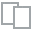
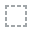
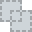
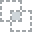
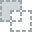
...
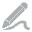
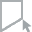
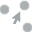
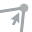
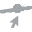

In [53]:
plot(df)

  0%|          | 0/110 [00:00<?, ?it/s]


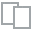
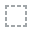
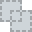
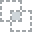
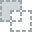
...
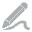
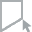
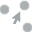
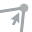
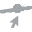

In [54]:
plot(df, 'Chemistry_ChilledWater_Demand_kBtu')

  0%|          | 0/110 [00:00<?, ?it/s]


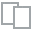
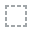
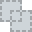
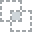
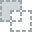
...
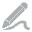
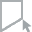
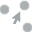
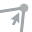
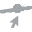

In [55]:
plot(df, 'aiTIT4045')

  0%|          | 0/110 [00:00<?, ?it/s]


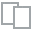
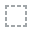
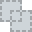
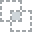
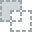
...
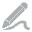
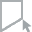
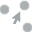
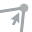
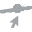

In [56]:
plot(df, 'HDH')

  0%|          | 0/110 [00:00<?, ?it/s]


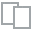
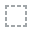
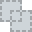
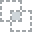
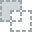
...
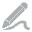
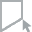
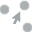
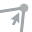
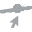

In [57]:
plot(df, 'CDH')

  0%|          | 0/72 [00:00<?, ?it/s]


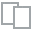
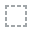
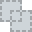
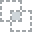
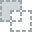
...
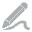
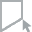
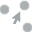
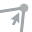
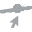

In [58]:
plot(df, 'DayOfWeek')

  0%|          | 0/110 [00:00<?, ?it/s]


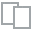
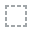
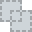
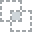
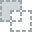
...
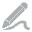
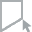
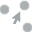
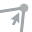
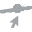

In [59]:
plot(df, 'Month')

  0%|          | 0/110 [00:00<?, ?it/s]


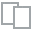
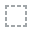
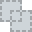
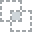
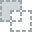
...
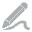
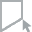
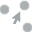
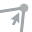
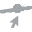

In [60]:
plot(df, 'Hour')

  0%|          | 0/72 [00:00<?, ?it/s]


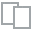
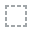
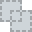
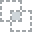
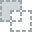
...
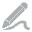
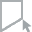
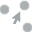
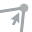
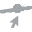

In [61]:
plot(df, 'Holiday')

## Cleaning data

In [114]:
df = df[df['Chemistry_ChilledWater_Demand_kBtu'] > 0]

df.dropna(axis=0, inplace=True)
df.set_index('Timestamp',inplace = True)

df_out = df[['Chemistry_ChilledWater_Demand_kBtu','aiTIT4045']].copy()
IQR = df_out.quantile(0.75) - df_out.quantile(0.25)
df_final = df_out[~((df_out < (df_out.quantile(0.25) - 3 * IQR)) | (df_out > (df_out.quantile(0.75) + 3 * IQR)))]

df_final.dropna(axis=0, inplace=True)

df_final.reset_index(inplace=True)
df = df.loc[df_final['Timestamp']]
df.reset_index(inplace = True)


<ipython-input-114-86e9be03375b>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(axis=0, inplace=True)


Text(0, 0.5, 'Demand kBtu')

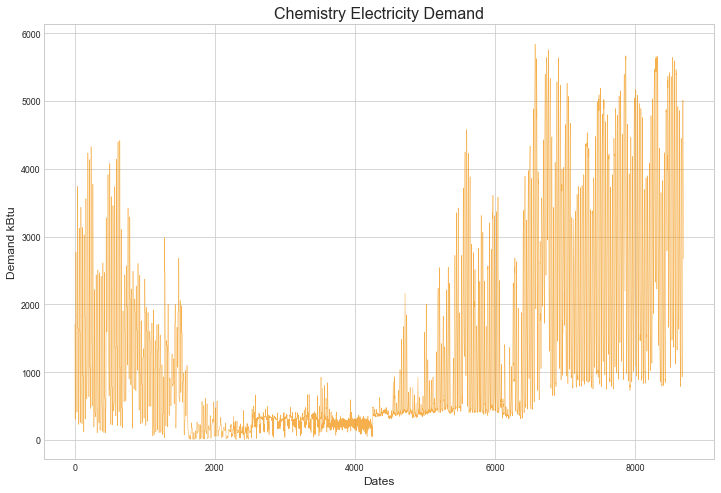

In [115]:
plt.figure(figsize=(12,8))
plt.plot(df['Chemistry_ChilledWater_Demand_kBtu'], color='#F18F01', linewidth=0.5, alpha = 0.7)


plt.title('Chemistry Electricity Demand', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


In [245]:
#outliers
#size = df['Chemistry_ChilledWater_Demand_kBtu'].shape[0]
#y = df['Chemistry_ChilledWater_Demand_kBtu']
#removed_outliers = y.between(y.quantile(.15), y.quantile(.85))

#print(str(y[removed_outliers].size) + "/" + str(size) + " data points remain.") 


In [246]:
#index = df[~removed_outliers].index 
#df.drop(index, inplace=True)


In [247]:
#plot(df, 'Chemistry_ChilledWater_Demand_kBtu')

In [248]:
#outliers
#size = df['aiTIT4045'].shape[0]
#y = df['aiTIT4045']
#removed_outliers = y.between(y.quantile(.05), y.quantile(.95))

#print(str(y[removed_outliers].size) + "/" + str(size) + " data points remain.") 


In [249]:
#index = df[~removed_outliers].index 
#df.drop(index, inplace=True)


In [250]:
#plot(df, 'aiTIT4045')


In [116]:
from dataprep.eda import plot_correlation


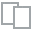
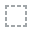
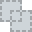
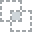
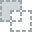
...
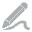
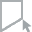
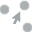
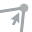
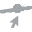

In [117]:
plot_correlation(df)

In [118]:
df.drop(['aiTIT4045', 'DayOfWeek'], inplace=True, axis=1)


## Split

In [36]:
from sklearn.model_selection import train_test_split 

In [119]:
x = df.drop('Chemistry_ChilledWater_Demand_kBtu', axis = 1)
y = df['Chemistry_ChilledWater_Demand_kBtu'].values.reshape(-1,1)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.1, shuffle = False)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size = 0.5, shuffle = False)

print("Shape of X_train is ", X_train.shape)
print("Shape of X_test is ", X_test.shape)
print("Shape of y_val is ", y_val.shape)
print("Shape of y_train is ", y_train.shape)
print("Shape of y_test is ", y_test.shape)
print("Shape of y_val is ", y_val.shape)


Shape of X_train is  (7821, 6)
Shape of X_test is  (435, 6)
Shape of y_val is  (435, 1)
Shape of y_train is  (7821, 1)
Shape of y_test is  (435, 1)
Shape of y_val is  (435, 1)


In [120]:
dates_train = X_train['Timestamp']
dates_test = X_test['Timestamp']
dates_val = X_val['Timestamp']
X_train.drop('Timestamp', axis = 1, inplace = True)
X_test.drop('Timestamp', axis = 1, inplace = True)
X_val.drop('Timestamp', axis = 1, inplace = True)


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Optimization

In [39]:
from sklearn.ensemble import GradientBoostingRegressor

In [40]:
from sklearn.model_selection import RandomizedSearchCV

In [121]:
# Hyperparameter grid
param_grid = {'criterion':['friedman_mse', 'mse'], 'loss':['ls','lad'],'learning_rate':[0.1,0.01, 0.001, 0.05],                               
              'n_estimators':np.linspace(10, 200).astype(int), 'random_state':[1], 'min_samples_split': [2, 5, 10],
             'max_depth': [None] + list(np.linspace(3, 20).astype(int)), 'max_leaf_nodes': [None] + list(np.linspace(10, 50, 500).astype(int))}

# Estimator for use in random search
estimator = GradientBoostingRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_jobs=-1,
                   param_distributions={'criterion': ['friedman_mse', 'mse'],
                                        'learning_rate': [0.1, 0.01, 0.001,
                                                          0.05],
                                        'loss': ['ls', 'lad'],
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                                                      8, 8, 9, 9, 9, 10, 10, 10,
                                                      11, 11, 12, 12, 12, ...],
                                        'max_leaf_nodes': [None, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 11,
                                                           11, 11, 11, 11, 11,
  

In [122]:
rs.best_params_


{'random_state': 1,
 'n_estimators': 188,
 'min_samples_split': 10,
 'max_leaf_nodes': 23,
 'max_depth': 12,
 'loss': 'ls',
 'learning_rate': 0.1,
 'criterion': 'friedman_mse'}

## Model

In [123]:
model = GradientBoostingRegressor(n_estimators = 188, learning_rate = 0.1, loss = 'ls', criterion = 'friedman_mse', 
                                  random_state = 1, min_samples_split = 10, max_leaf_nodes = 23, max_depth = 12)
model.fit(X_train, y_train)


/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


GradientBoostingRegressor(max_depth=12, max_leaf_nodes=23, min_samples_split=10,
                          n_estimators=188, random_state=1)

In [124]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


### Measures

In [125]:
from sklearn import metrics
from statistics import mean

In [126]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 45108.688309536614
Root Mean Squared Error: 212.38806065675305
Mean Absolute Error: 160.44984183472113
CV(RMSE):  0.0767808506054157


In [127]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.9755036852719958
Testing R-squared:  0.9774785219508891
Validation R-squared:  0.9467000732546347


In [128]:
boost_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
boost_scores

,Measure,Train,Test,Val
0,MSE,36432.91881249363,45108.688309536614,113377.33440951345
1,RMSE,190.87409151714024,212.38806065675305,336.71550960642344
2,MAE,115.349807298629,160.44984183472113,246.39824867400657
3,CV(RMSE),0.17693307044069007,0.0767808506054157,0.10709345184521267
4,R-squared,0.9755036852719958,0.9774785219508891,0.9467000732546347


In [129]:
#measures.to_csv('scores_annhour.csv', index = False)

In [130]:
import matplotlib as mpl
mpl.style.use('seaborn-whitegrid')

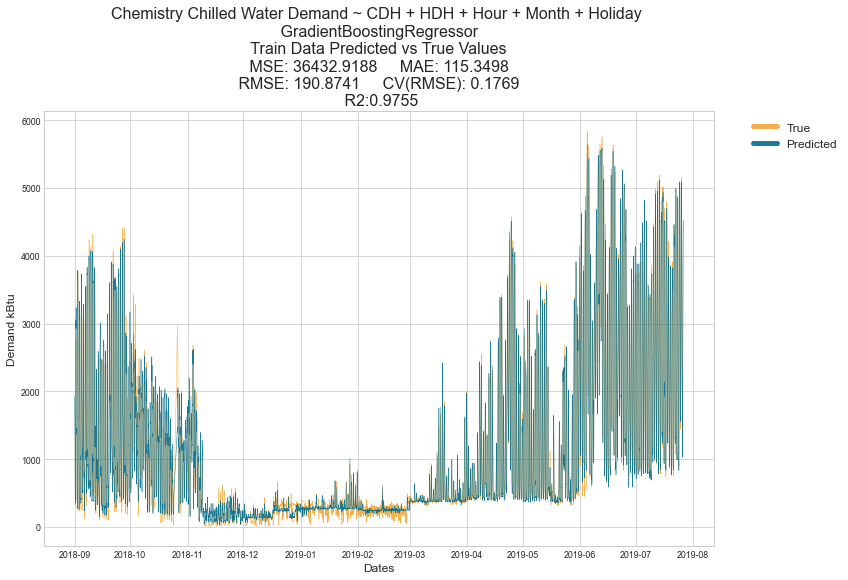

In [131]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n GradientBoostingRegressor \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

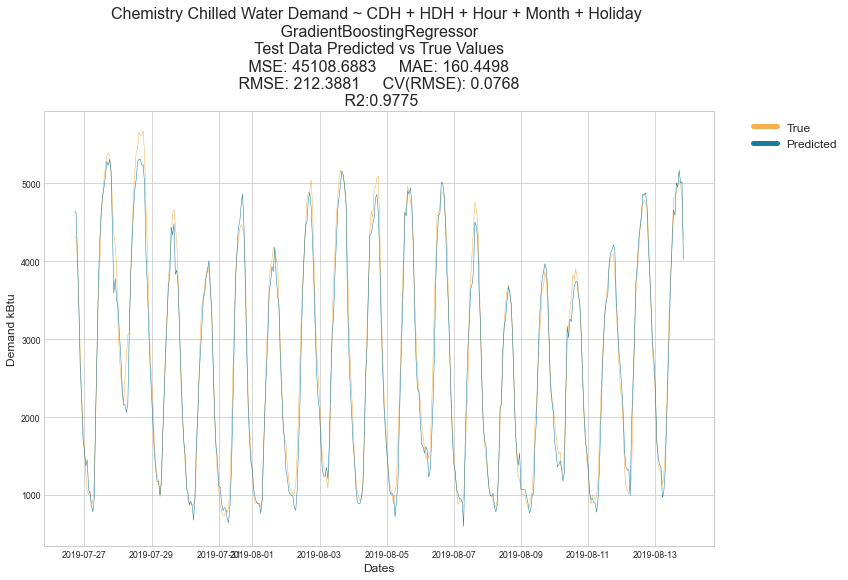

In [132]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n GradientBoostingRegressor \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

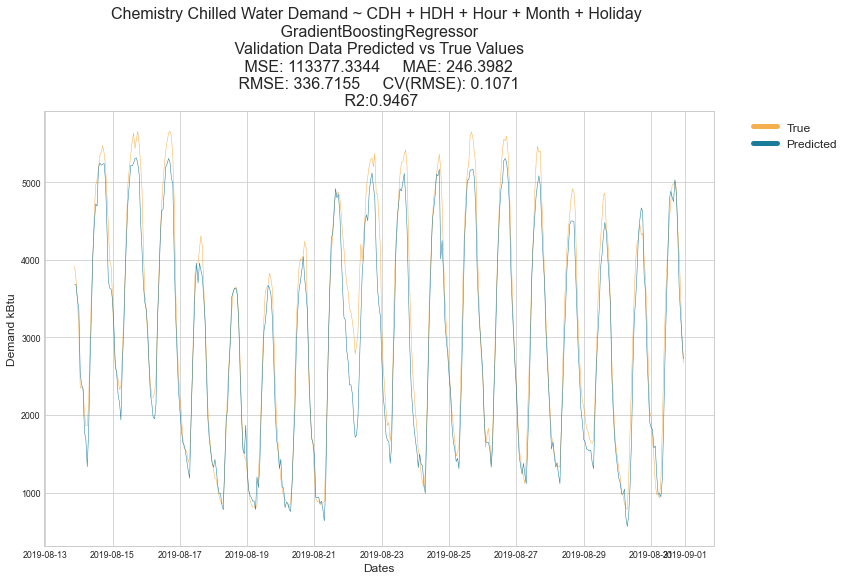

In [133]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n GradientBoostingRegressor \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)


# Random Forest

In [134]:
from sklearn.ensemble import RandomForestRegressor

In [135]:
# Hyperparameter grid
param_grid = {
    'n_estimators': np.linspace(10, 200).astype(int),
    'max_depth': [None] + list(np.linspace(3, 20).astype(int)),
    'max_leaf_nodes': [None] + list(np.linspace(10, 50, 500).astype(int)),
    'min_samples_split': [2, 5, 10],
    'bootstrap': [True, False],
    'random_state': [1]
}

# Estimator for use in random search
estimator = RandomForestRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_train, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/opt/anaconda3/lib/python3.8/site-packages/sklearn/model_selection/_search.py:880: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 3, 3, 3, 4, 4, 4, 5,
                                                      5, 5, 6, 6, 6, 7, 7, 7, 8,
                                                      8, 8, 9, 9, 9, 10, 10, 10,
                                                      11, 11, 12, 12, 12, ...],
                                        'max_leaf_nodes': [None, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 10,
                                                           10, 10, 10, 10, 11,
                                                           11, 11, 11, 11, 11,
                                                           11, 11, 11, 11, 11,
                                                           11, 12, 12, 12, 12, ...],
                                        'min_samples_spl

In [136]:
rs.best_params_

{'random_state': 1,
 'n_estimators': 17,
 'min_samples_split': 5,
 'max_leaf_nodes': 45,
 'max_depth': 7,
 'bootstrap': True}

## Model

In [137]:
model = RandomForestRegressor(n_estimators = 17, 
                               bootstrap = True,
                               max_depth = 7,
                               max_leaf_nodes = 45,
                               min_samples_split = 5,
                               random_state = 1)
model.fit(X_train, y_train)

<ipython-input-137-53a130877511>:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


RandomForestRegressor(max_depth=7, max_leaf_nodes=45, min_samples_split=5,
                      n_estimators=17, random_state=1)

In [138]:
pred_train = model.predict(X_train)
pred_test = model.predict(X_test)
pred_val = model.predict(X_val)


In [139]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 68885.82192695771
Root Mean Squared Error: 262.4610865003757
Mean Absolute Error: 206.4042356050768
CV(RMSE):  0.09488285457292575


In [140]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.9467102059302184
Testing R-squared:  0.9656072791171153
Validation R-squared:  0.9347766954984201


In [141]:
forest_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
forest_scores


,Measure,Train,Test,Val
0,MSE,79256.9316011984,68885.82192695771,138740.23581865735
1,RMSE,281.52607623663994,262.4610865003757,372.4785038343251
2,MAE,173.33729986318988,206.4042356050768,287.4526802161339
3,CV(RMSE),0.2609640348868171,0.09488285457292575,0.1184679872940346
4,R-squared,0.9467102059302184,0.9656072791171153,0.9347766954984201


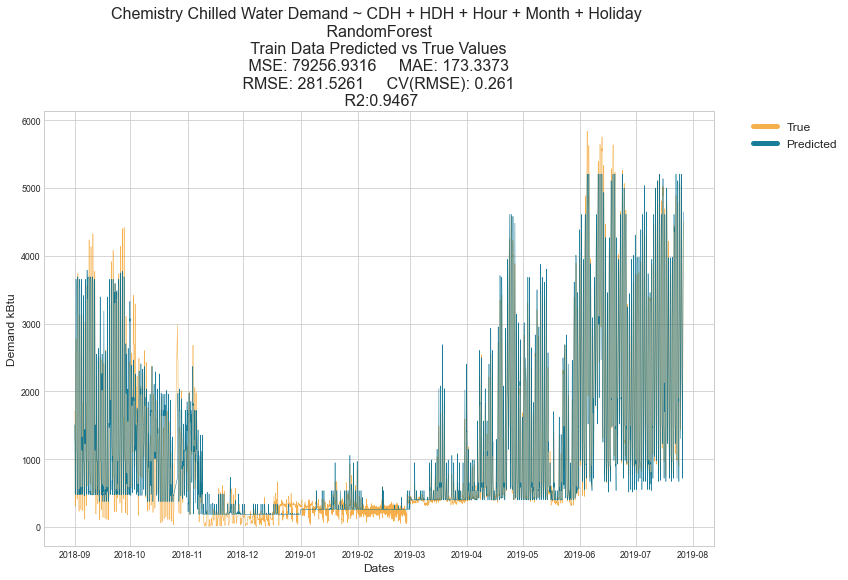

In [142]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n RandomForest \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

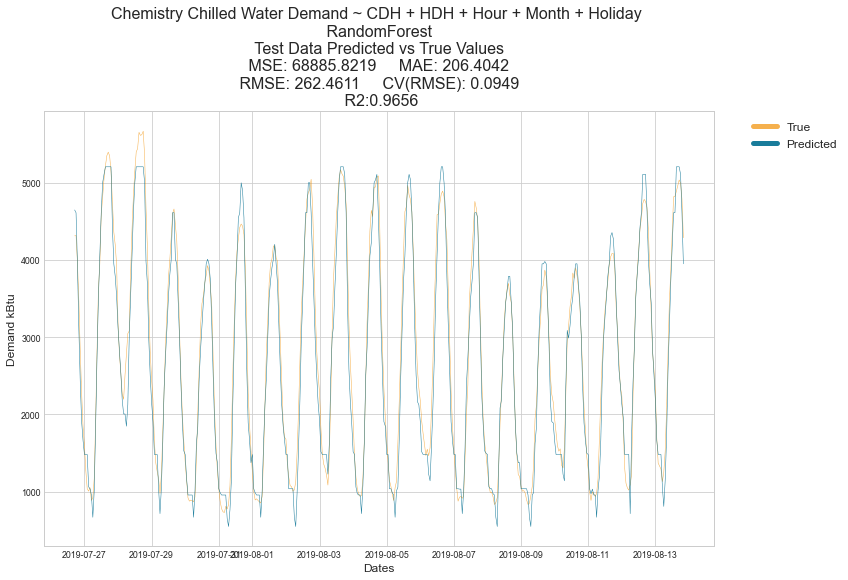

In [143]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n RandomForest \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

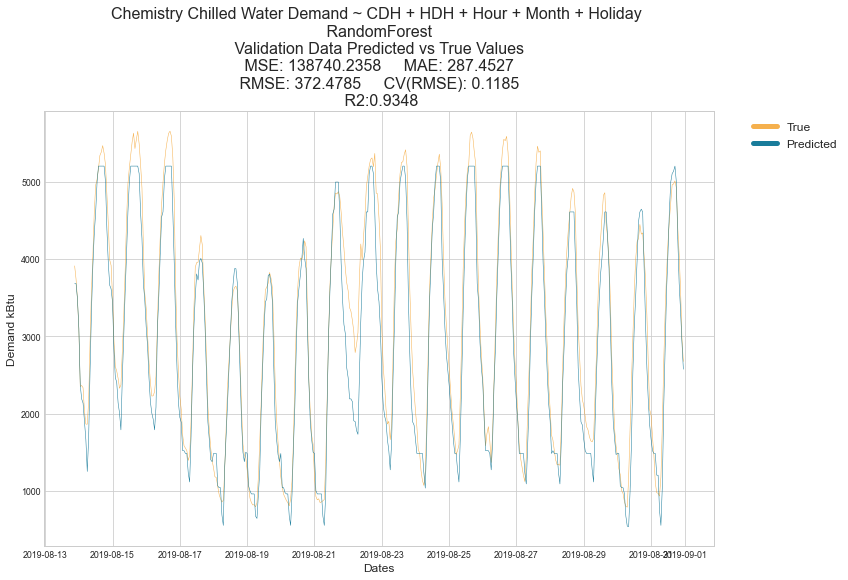

In [144]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n RandomForest \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

# Linear Regression

## Dummies

In [145]:
df_dd = df.copy()

In [146]:
dummy_h = pd.get_dummies(df_dd['Hour'])
dummy_h.head()

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [147]:
df_h_dummies = pd.concat([df_dd, dummy_h], axis=1)      
df_h_dummies.drop(['Hour', 23], inplace=True, axis=1)
df_h_dummies = df_h_dummies.rename(columns={0:'h_0', 1: 'h_1', 2:'h_2', 3:'h_3', 4:'h_4', 5:'h_5', 6:'h_6', 
                                              7:'h_7', 8:'h_8', 9:'h_9', 10:'h_10', 11:'h_11', 12:'h_12', 
                                              13:'h_13',14:'h_14',15:'h_15',16:'h_16',17:'h_17',18:'h_18',
                                              19:'h_19',20:'h_20',21:'h_21',22:'h_22'})
df_h_dummies.head()

,Timestamp,Chemistry_ChilledWater_Demand_kBtu,HDH,CDH,Holiday,Month,h_0,h_1,h_2,h_3,...,h_13,h_14,h_15,h_16,h_17,h_18,h_19,h_20,h_21,h_22
0,2018-09-01 00:00:00,1704.0,0.000000,4.289731,1.0,9,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2018-09-01 01:00:00,1704.0,0.000000,0.318193,1.0,9,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2018-09-01 02:00:00,1704.0,0.635047,0.403285,1.0,9,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,2018-09-01 03:00:00,1704.0,0.995677,0.991373,1.0,9,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,2018-09-01 04:00:00,1704.0,1.712568,2.932888,1.0,9,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [148]:
dummy_m = pd.get_dummies(df_dd['Month'])
dummy_m.head()

,1,2,3,4,5,6,7,8,9,10,11,12
0,0,0,0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0


In [149]:
df_m_dummies = pd.concat([df_h_dummies, dummy_m], axis=1)      
df_m_dummies.drop(['Month', 12], inplace=True, axis=1)
df_m_dummies = df_m_dummies.rename(columns={1: 'm_1', 2:'m_2', 3:'m_3', 4:'m_4', 5:'m_5', 6:'m_6', 
                                              7:'m_7', 8:'m_8', 9:'m_9', 10:'m_10', 11:'m_11'})
df_m_dummies.head()

,Timestamp,Chemistry_ChilledWater_Demand_kBtu,HDH,CDH,Holiday,h_0,h_1,h_2,h_3,h_4,...,m_2,m_3,m_4,m_5,m_6,m_7,m_8,m_9,m_10,m_11
0,2018-09-01 00:00:00,1704.0,0.000000,4.289731,1.0,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,2018-09-01 01:00:00,1704.0,0.000000,0.318193,1.0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,2018-09-01 02:00:00,1704.0,0.635047,0.403285,1.0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
3,2018-09-01 03:00:00,1704.0,0.995677,0.991373,1.0,0,0,0,1,0,...,0,0,0,0,0,0,0,1,0,0
4,2018-09-01 04:00:00,1704.0,1.712568,2.932888,1.0,0,0,0,0,1,...,0,0,0,0,0,0,0,1,0,0


In [302]:
#dummy_w = pd.get_dummies(df_dd['DayOfWeek'])
#dummy_w.head()

In [132]:
#df_w_dummies = pd.concat([df_m_dummies, dummy_w], axis=1)      
#df_w_dummies.drop(['DayOfWeek', 6], inplace=True, axis=1)
#df_w_dummies = df_w_dummies.rename(columns={0:'Sunday', 1: 'Monday', 2:'Tuesday', 3:'Wednesday', 4:'Thursday', 5:'Friday'})
#df_w_dummies.head()

In [133]:
#from patsy import dmatrices
#from statsmodels.stats.outliers_influence import variance_inflation_factor

In [134]:
#y, X = dmatrices('Chemistry_ChilledWater_Demand_kBtu ~ CDH+Holiday+h_1+h_2+h_3+h_4+h_5+h_6+h_7+h_8+h_9+h_10+h_11+h_12+h_13+h_14+h_15+h_16+h_17+h_18+h_19+h_20+h_21+h_22+m_1+m_2+m_3+m_4+m_5+m_6+m_7+m_8+m_9+m_10+m_11+Sunday+Monday+Tuesday+Wednesday+Thursday+Friday', data = df_w_dummies, return_type = 'dataframe')

#vif = pd.DataFrame()
#vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
#vif['variable'] = X.columns
#vif

## Split

In [150]:
x = df_m_dummies.drop('Chemistry_ChilledWater_Demand_kBtu', axis = 1)
y = df_m_dummies['Chemistry_ChilledWater_Demand_kBtu'].values.reshape(-1,1)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.1, shuffle = False)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size = 0.5, shuffle = False)

print("Shape of X_train is ", X_train.shape)
print("Shape of X_test is ", X_test.shape)
print("Shape of y_val is ", y_val.shape)
print("Shape of y_train is ", y_train.shape)
print("Shape of y_test is ", y_test.shape)
print("Shape of y_val is ", y_val.shape)

Shape of X_train is  (7821, 38)
Shape of X_test is  (435, 38)
Shape of y_val is  (435, 1)
Shape of y_train is  (7821, 1)
Shape of y_test is  (435, 1)
Shape of y_val is  (435, 1)


In [151]:
dates_train = X_train['Timestamp']
dates_test = X_test['Timestamp']
dates_val = X_val['Timestamp']
X_train.drop('Timestamp', axis = 1, inplace = True)
X_test.drop('Timestamp', axis = 1, inplace = True)
X_val.drop('Timestamp', axis = 1, inplace = True)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Model

In [72]:
from sklearn.linear_model import LinearRegression

In [152]:
model_m = LinearRegression()
model_m.fit(X_train, y_train)


LinearRegression()

In [153]:
pred_train = model_m.predict(X_train)
pred_test = model_m.predict(X_test)
pred_val = model_m.predict(X_val)


In [154]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 739388.5562382416
Root Mean Squared Error: 859.8770587928495
Mean Absolute Error: 713.7797396736163
CV(RMSE):  0.31085594823947466


In [155]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.8164270693079817
Testing R-squared:  0.6308444389955178
Validation R-squared:  0.41829608004421903


In [156]:
lreg_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
lreg_scores


,Measure,Train,Test,Val
0,MSE,273024.6469452807,739388.5562382416,1237375.8068229663
1,RMSE,522.5176044357555,859.8770587928495,1112.3739509818479
2,MAE,354.9419503497346,713.7797396736163,970.113014909894
3,CV(RMSE),0.48435407538707376,0.31085594823947466,0.35379411626327684
4,R-squared,0.8164270693079817,0.6308444389955178,0.41829608004421903


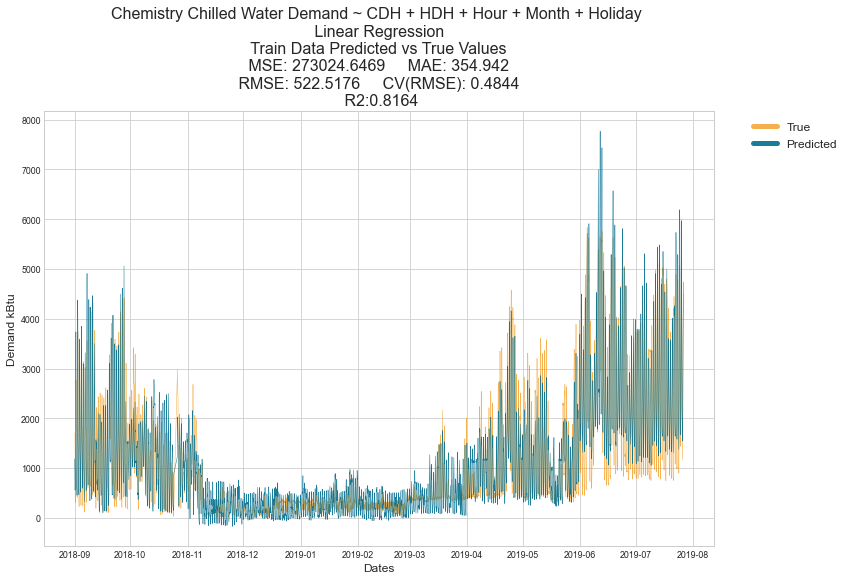

In [157]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n Linear Regression \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

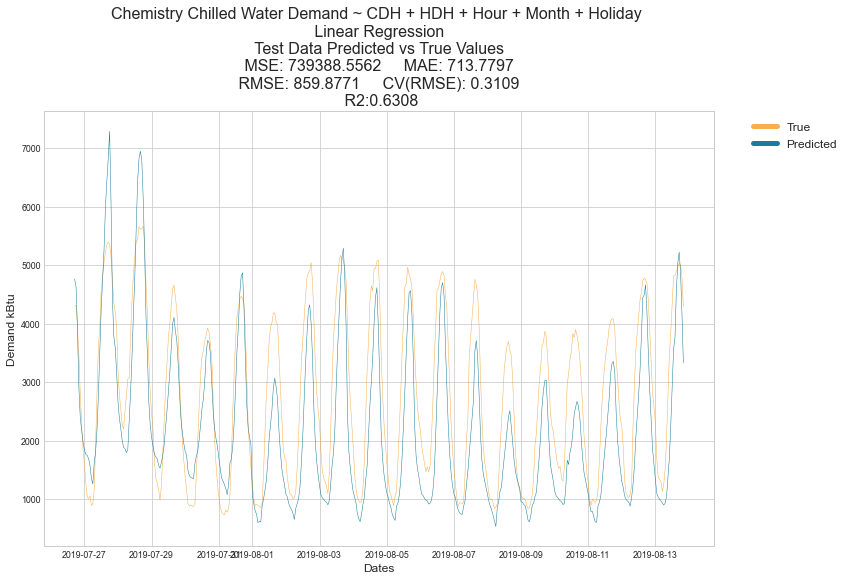

In [158]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n Linear Regression \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

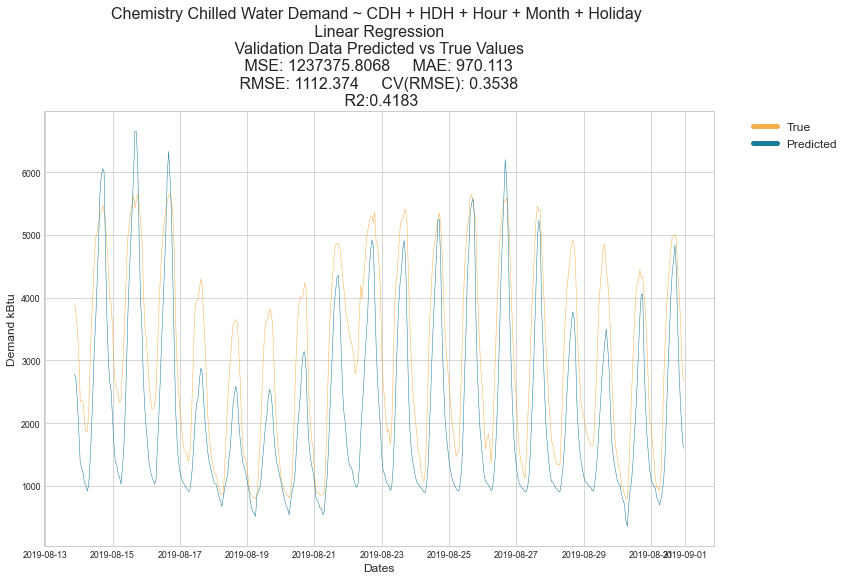

In [159]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n Linear Regression \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)


leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

# ANN

In [81]:
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler


In [160]:
df.head()

,Timestamp,Chemistry_ChilledWater_Demand_kBtu,HDH,CDH,Holiday,Month,Hour
0,2018-09-01 00:00:00,1704.0,0.000000,4.289731,1.0,9,0
1,2018-09-01 01:00:00,1704.0,0.000000,0.318193,1.0,9,1
2,2018-09-01 02:00:00,1704.0,0.635047,0.403285,1.0,9,2
3,2018-09-01 03:00:00,1704.0,0.995677,0.991373,1.0,9,3
4,2018-09-01 04:00:00,1704.0,1.712568,2.932888,1.0,9,4


## Split

In [161]:
x = df.drop('Chemistry_ChilledWater_Demand_kBtu', axis = 1)
y = df['Chemistry_ChilledWater_Demand_kBtu'].values.reshape(-1,1)

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.1, shuffle = False)
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size = 0.5, shuffle = False)

print("Shape of X_train is ", X_train.shape)
print("Shape of X_test is ", X_test.shape)
print("Shape of y_val is ", y_val.shape)
print("Shape of y_train is ", y_train.shape)
print("Shape of y_test is ", y_test.shape)
print("Shape of y_val is ", y_val.shape)


Shape of X_train is  (7821, 6)
Shape of X_test is  (435, 6)
Shape of y_val is  (435, 1)
Shape of y_train is  (7821, 1)
Shape of y_test is  (435, 1)
Shape of y_val is  (435, 1)


In [162]:
dates_train = X_train['Timestamp']
dates_test = X_test['Timestamp']
dates_val = X_val['Timestamp']
X_train.drop('Timestamp', axis = 1, inplace = True)
X_test.drop('Timestamp', axis = 1, inplace = True)
X_val.drop('Timestamp', axis = 1, inplace = True)


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


## Standarization

In [163]:
scaler = MinMaxScaler()
X_trainscaled = scaler.fit_transform(X_train)
X_testscaled = scaler.fit_transform(X_test)
X_valscaled = scaler.fit_transform(X_val)


In [164]:
# Hyperparameter grid
param_grid = {'activation':['identity','logistic','tanh','relu'], 'solver':['lbfgs','sgd','adam'],                               
              'shuffle':[False], 'hidden_layer_sizes':[(20,20,20),(15,30,45),(45,30,15),
                                                        (30,30,30),(25,25),(20,20),
                                                        (35,35),(40),(40,40),(30,30),
                                                        (45,45),(50,50,50),(30),(30,30,30,30),
                                                        (20,20,20,20)]}

# Estimator for use in random search
estimator = MLPRegressor()

# Create the random search model
rs = RandomizedSearchCV(estimator, param_grid, n_jobs = -1, 
                        scoring = 'neg_root_mean_squared_error', cv = 5, 
                        n_iter = 10, verbose = 1)

# Fit 
rs.fit(X_trainscaled, y_train)


Fitting 5 folds for each of 10 candidates, totalling 50 fits


/opt/anaconda3/lib/python3.8/site-packages/sklearn/model_selection/_search.py:922: UserWarning: One or more of the test scores are non-finite: [-1.67070215e+09             nan -1.87385991e+03 -6.11281935e+02
 -1.17024582e+03             nan -5.07500917e+11 -1.15836578e+03
 -6.26811915e+02             nan]
  warnings.warn(
/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


RandomizedSearchCV(cv=5, estimator=MLPRegressor(), n_jobs=-1,
                   param_distributions={'activation': ['identity', 'logistic',
                                                       'tanh', 'relu'],
                                        'hidden_layer_sizes': [(20, 20, 20),
                                                               (15, 30, 45),
                                                               (45, 30, 15),
                                                               (30, 30, 30),
                                                               (25, 25),
                                                               (20, 20),
                                                               (35, 35), 40,
                                                               (40, 40),
                                                               (30, 30),
                                                               (45, 45),
                                     

In [165]:
rs.best_params_


{'solver': 'lbfgs',
 'shuffle': False,
 'hidden_layer_sizes': (45, 45),
 'activation': 'identity'}

In [166]:
model = MLPRegressor(hidden_layer_sizes = (45,45), activation = 'identity', shuffle = False,
                    random_state = 1, max_iter = 1000, solver = 'lbfgs')
model.fit(X_trainscaled, y_train)


/opt/anaconda3/lib/python3.8/site-packages/sklearn/utils/validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


MLPRegressor(activation='identity', hidden_layer_sizes=(45, 45), max_iter=1000,
             random_state=1, shuffle=False, solver='lbfgs')

In [167]:
pred_train = model.predict(X_trainscaled)
pred_test = model.predict(X_testscaled)
pred_val = model.predict(X_valscaled)


In [168]:
#train
mse_train = metrics.mean_squared_error(y_train, pred_train)
rmse_train = np.sqrt(metrics.mean_squared_error(y_train, pred_train))
mae_train = metrics.mean_absolute_error(y_train, pred_train)
cv_rmse_train = rmse_train / mean(y_train.flatten())

#test
mse_test = metrics.mean_squared_error(y_test, pred_test)
rmse_test = np.sqrt(metrics.mean_squared_error(y_test, pred_test))
mae_test = metrics.mean_absolute_error(y_test, pred_test)
cv_rmse_test = rmse_test / mean(y_test.flatten())

#val
mse_val = metrics.mean_squared_error(y_val, pred_val)
rmse_val = np.sqrt(metrics.mean_squared_error(y_val, pred_val))
mae_val = metrics.mean_absolute_error(y_val, pred_val)
cv_rmse_val = rmse_val / mean(y_val.flatten())

print('Mean Squared Error:', mse_test) 
print('Root Mean Squared Error:', rmse_test)
print('Mean Absolute Error:', mae_test)
print('CV(RMSE): ', cv_rmse_test)


Mean Squared Error: 787124.2485515884
Root Mean Squared Error: 887.2002302477093
Mean Absolute Error: 721.5306393886574
CV(RMSE):  0.32073360491685365


In [169]:
r2_train = metrics.r2_score(y_train, pred_train)
r2_test = metrics.r2_score(y_test, pred_test)
r2_val = metrics.r2_score(y_val, pred_val)
print('Training R-squared: ', r2_train)
print('Testing R-squared: ', r2_test)
print('Validation R-squared: ', r2_val)


Training R-squared:  0.7682114423060951
Testing R-squared:  0.6070113729746895
Validation R-squared:  0.613382017360441


In [170]:
ann_scores = pd.DataFrame(np.array([['MSE', mse_train, mse_test, mse_val], ['RMSE', rmse_train, rmse_test, rmse_val], ['MAE', mae_train, mae_test, mae_val], ['CV(RMSE)', cv_rmse_train, cv_rmse_test, cv_rmse_val], ['R-squared', r2_train, r2_test, r2_val]]), columns=['Measure', 'Train', 'Test', 'Val'])
ann_scores


,Measure,Train,Test,Val
0,MSE,344734.8630964892,787124.2485515884,822397.3086467383
1,RMSE,587.1412633229667,887.2002302477093,906.8612400178642
2,MAE,383.63370222147347,721.5306393886574,748.9236542067199
3,CV(RMSE),0.5442577652967088,0.32073360491685365,0.28843013691784597
4,R-squared,0.7682114423060951,0.6070113729746895,0.613382017360441


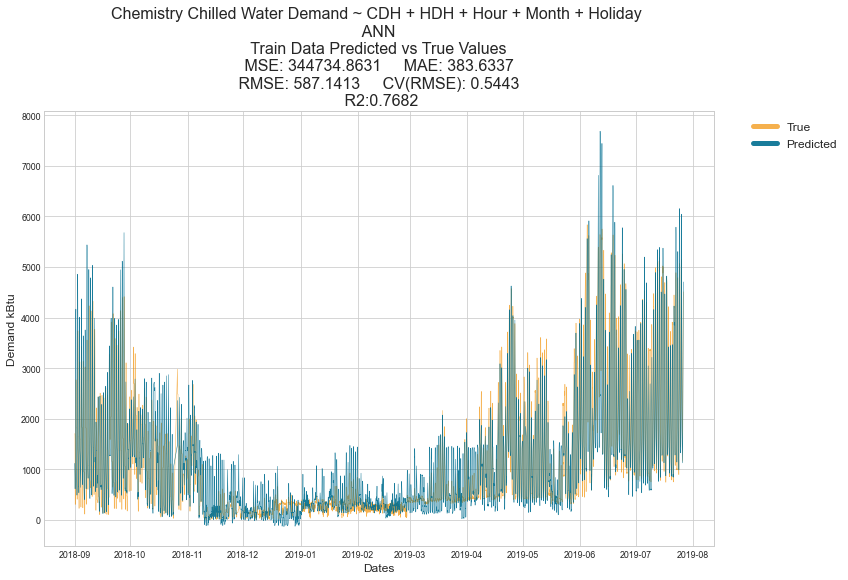

In [171]:
plt.figure(figsize=(12,8))
plt.plot(dates_train, y_train, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_train, pred_train, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n ANN \n Train Data Predicted vs True Values \n MSE: {round(mse_train, 4)}     MAE: {round(mae_train,4)} \n RMSE: {round(rmse_train, 4)}     CV(RMSE): {round(cv_rmse_train, 4)} \n R2:{round(r2_train,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)

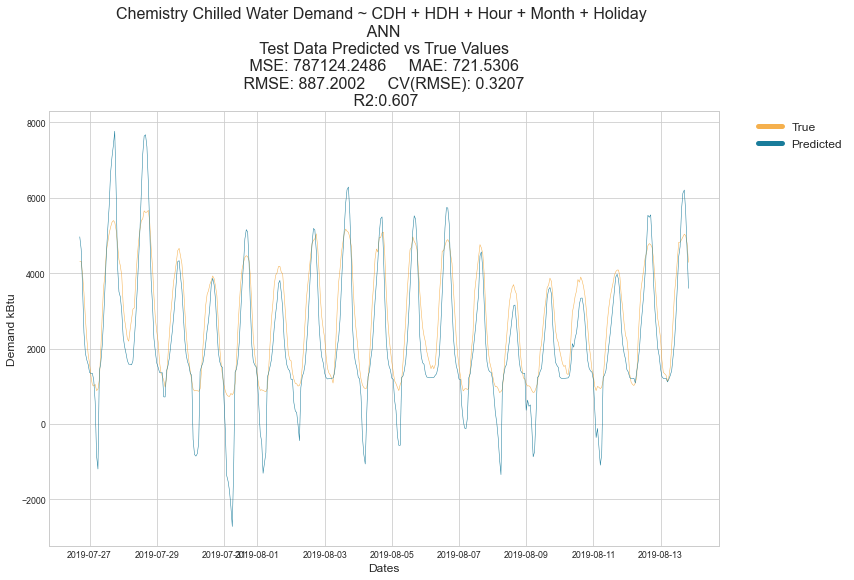

In [172]:
plt.figure(figsize=(12,8))
plt.plot(dates_test, y_test, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_test, pred_test, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n ANN \n Test Data Predicted vs True Values \n MSE: {round(mse_test, 4)}     MAE: {round(mae_test,4)} \n RMSE: {round(rmse_test, 4)}     CV(RMSE): {round(cv_rmse_test, 4)} \n R2:{round(r2_test,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

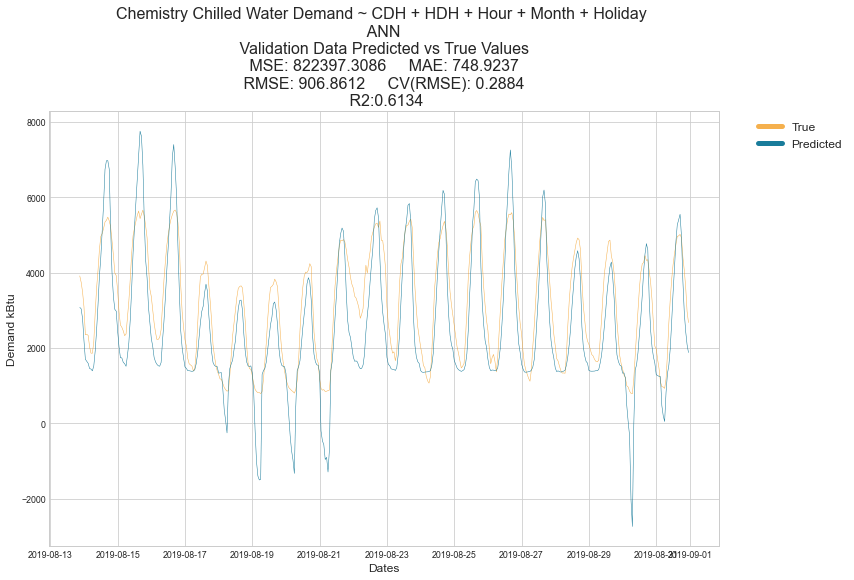

In [173]:
plt.figure(figsize=(12,8))
plt.plot(dates_val, y_val, color='#F18F01', linewidth=0.5, alpha = 0.7)
plt.plot(dates_val, pred_val, color='#006E90', linewidth=0.5, alpha = 0.9)

plt.title(f'Chemistry Chilled Water Demand ~ CDH + HDH + Hour + Month + Holiday \n ANN \n Validation Data Predicted vs True Values \n MSE: {round(mse_val, 4)}     MAE: {round(mae_val,4)} \n RMSE: {round(rmse_val, 4)}     CV(RMSE): {round(cv_rmse_val, 4)} \n R2:{round(r2_val,4)}', fontsize = 16)
plt.xlabel('Dates', fontsize = 12)
plt.ylabel('Demand kBtu', fontsize = 12)

leg = plt.legend(labels = ['True','Predicted'], loc = "upper right", bbox_to_anchor=(1.2, 1), fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    

# Comparisson

In [174]:
#r2
r2 = pd.DataFrame()
r2['Dataset'] = ['Train', 'Test', 'Validation']
r2['OLS'] = lreg_scores[lreg_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['RandomForest'] = forest_scores[forest_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['ANN'] = ann_scores[ann_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'R-squared'].values.flatten()[1:4].astype('float64')
r2.set_index('Dataset', drop = True, inplace = True)

#cv(rmse)
cv = pd.DataFrame()
cv['Dataset'] = ['Train', 'Test', 'Validation']
cv['OLS'] = lreg_scores[lreg_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['RandomForest'] = forest_scores[forest_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['ANN'] = ann_scores[ann_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'CV(RMSE)'].values.flatten()[1:4].astype('float64')
cv.set_index('Dataset', drop = True, inplace = True)

#mae
mae = pd.DataFrame()
mae['Dataset'] = ['Train', 'Test', 'Validation']
mae['OLS'] = lreg_scores[lreg_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['RandomForest'] = forest_scores[forest_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['ANN'] = ann_scores[ann_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae['GradientBoosting'] = boost_scores[boost_scores['Measure'] == 'MAE'].values.flatten()[1:4].astype('float64')
mae.set_index('Dataset', drop = True, inplace = True)

mae

,OLS,RandomForest,ANN,GradientBoosting
Dataset,,,,
Train,354.941950,173.337300,383.633702,115.349807
Test,713.779740,206.404236,721.530639,160.449842
Validation,970.113015,287.452680,748.923654,246.398249


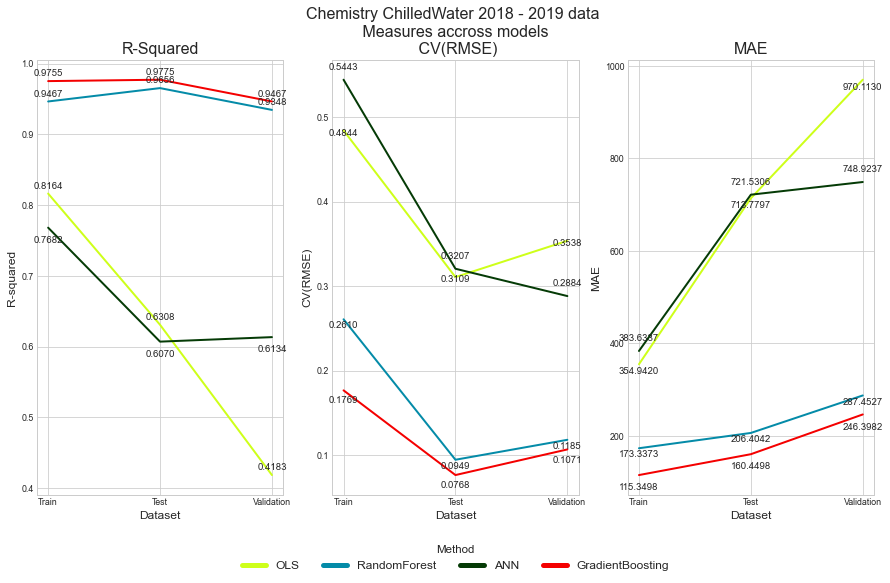

In [175]:
plt.figure(figsize=(15,8))

# R2
plt.subplot(1,3,1)
plt.plot(r2['OLS'], color='#CEFF1A', linewidth=2)
plt.plot(r2['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(r2['ANN'], color='#053B06', linewidth=2)
plt.plot(r2['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('R-Squared', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('R-squared', fontsize = 12)

for x,y in zip(['Train','Test','Validation'], r2['OLS']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['ANN']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-15), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], r2['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,5), ha = 'center') 

# CV(RMSE)
plt.subplot(1,3,2)
plt.plot(cv['OLS'], color='#CEFF1A', linewidth=2)
plt.plot(cv['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(cv['ANN'], color='#053B06', linewidth=2)
plt.plot(cv['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('Chemistry ChilledWater 2018 - 2019 data \n Measures accross models \n CV(RMSE)', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('CV(RMSE)', fontsize = 12)

leg = plt.legend(labels = ['OLS','RandomForest', 'ANN', 'GradientBoosting'], loc = "lower center", bbox_to_anchor=(0.5, -0.2),ncol = 4, title = 'Method', title_fontsize = 'large', fontsize = 12)

for line in leg.get_lines():
    line.set_linewidth(5.0)
    
for x,y in zip(['Train','Test','Validation'], cv['OLS']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-5), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-9), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['ANN']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], cv['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-13), ha = 'center') 
    
# MAE
plt.subplot(1,3,3)
plt.plot(mae['OLS'], color='#CEFF1A', linewidth=2)
plt.plot(mae['RandomForest'], color='#048BA8', linewidth=2)
plt.plot(mae['ANN'], color='#053B06', linewidth=2)
plt.plot(mae['GradientBoosting'], color='#F40000', linewidth=2)

plt.title('MAE', fontsize = 16)
plt.xlabel('Dataset', fontsize = 12)
plt.ylabel('MAE', fontsize = 12)

for x,y in zip(['Train','Test','Validation'], mae['OLS']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['RandomForest']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-9), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['ANN']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,10), ha = 'center') 
    
for x,y in zip(['Train','Test','Validation'], mae['GradientBoosting']):
    label = "{:.4f}".format(y)
    plt.annotate(label, (x,y), textcoords = "offset points", xytext = (0,-15), ha = 'center') 
